In [1]:
#import required libraries
import requests
from bs4 import BeautifulSoup
import pandas as pd
import numpy as np
import csv
#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim
#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium
from sklearn.cluster import KMeans 
from sklearn.datasets.samples_generator import make_blobs
from pandas.io.json import json_normalize
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import re
from branca.element import Template, MacroElement

import warnings
warnings.simplefilter('ignore')

pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [2]:
#Foursquare Credentials - Replace with your own
CLIENT_ID = 'LPY3HLVBWQP0KEA0LDOH2SBBWL3HPNNFRRDBYA0WCXVLKSO5' # your Foursquare ID
CLIENT_SECRET = 'VNQJXLWZAA0MP2TAAY0FYVNJKCALIJEYQ44NRI3MOXMFZQLH' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

In [3]:
#URL of site used to get Ireland counties and cities data
borough_url = 'http://citypopulation.de/php/usa-pennsylvania.php?adm2id=42003'

#data format is such that data can be read directly into tables
tables = pd.read_html(borough_url)

#create a county table and remove the last row as this is a Totals row which we don't need
borough_table = tables[1][:-1]

#First 5 rows of the dataframe
borough_table.head()

,Name,Status,County,PopulationCensus2000-04-01,PopulationCensus2010-04-01,PopulationEstimate2017-07-01,Unnamed: 6
0,Aspinwall,Borough,Allegheny,2860,2801,2732.0,→
1,Avalon,Borough,Allegheny,5280,4705,4586.0,→
2,Baldwin,Borough,Allegheny,19917,19767,19610.0,→
3,Bell Acres,Borough,Allegheny,1337,1390,1388.0,→
4,Bellevue,Borough,Allegheny,8769,8370,8159.0,→


In [4]:
#Extract only the Name column from the dataframe
df_borough = borough_table.filter(['Name'], axis=1)

#clean up the Name column
df_borough.Name = df_borough.Name.str.replace(r'\(.+\)','')
df_borough = df_borough.drop(df_borough.index[46])
df_borough.head()

,Name
0,Aspinwall
1,Avalon
2,Baldwin
3,Bell Acres
4,Bellevue


In [5]:
#get borough coordinates
latitudes = []
longitudes = []
for address in df_borough.Name:
    geolocator = Nominatim()
    location = geolocator.geocode(address)
    latitudes.append(location.latitude)
    longitudes.append(location.longitude)
    
df_borough['Latitude'] = latitudes
df_borough['Longitude'] = longitudes
print(df_borough.head())
print(df_borough.shape) 

         Name   Latitude   Longitude
0   Aspinwall  40.491242  -79.903510
1      Avalon  47.488537    3.907066
2     Baldwin  30.567753  -87.732439
3  Bell Acres  40.590067  -80.166448
4    Bellevue  47.614422 -122.192337
(87, 3)


In [6]:
#Function definition : getNearbyVenues from Foursquare
def getNearbyVenues(radius=2400):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):         
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [7]:
#retrieve the nearby venues within a range of 1.5 mile
LIMIT = 1000
names = df_borough.Name
latitudes = df_borough.Latitude
longitudes = df_borough.Longitude
venues_nearby = getNearbyVenues()

#First 5 rows of the dataframe
venues_nearby.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Aspinwall,40.491242,-79.90351,Randita's Organic Vegan Cafe,40.490189,-79.904924,Vegetarian / Vegan Restaurant
1,Aspinwall,40.491242,-79.90351,Esspa Kozmetika Organic Skincare,40.489430,-79.901057,Spa
2,Aspinwall,40.491242,-79.90351,Labriola's Italian Market,40.488284,-79.898610,Italian Restaurant
3,Aspinwall,40.491242,-79.90351,Burgatory,40.489315,-79.892910,Burger Joint
4,Aspinwall,40.491242,-79.90351,CC's Café,40.493595,-79.914514,Italian Restaurant


In [8]:
#category mapping
majorCategoryMap = {'American Restaurant':'Restaurant',
                'Asian Restaurant':'Restaurant',
                'Chinese Restaurant':'Restaurant',
                'Doner Restaurant':'Restaurant',
                'French Restaurant':'Restaurant',
                'Greek Restaurant':'Restaurant',
                'Indian Restaurant':'Restaurant',
                'Indonesian Restaurant':'Restaurant',
                'Italian Restaurant':'Restaurant',
                'Japanese Restaurant':'Restaurant',
                'Korean Restaurant':'Restaurant',
                'Mediterranean Restaurant':'Restaurant',
                'Mexican Restaurant':'Restaurant',
                'Middle Eastern Restaurant':'Restaurant',
                'Molecular Gastronomy Restaurant':'Restaurant',
                'Persian Restaurant':'Restaurant',
                'Portuguese Restaurant':'Restaurant',
                'Seafood Restaurant':'Restaurant',
                'Spanish Restaurant':'Restaurant',
                'Steakhouse':'Restaurant',
                'Sushi Restaurant':'Restaurant',
                'Tapas Restaurant':'Restaurant',
                'Thai Restaurant':'Restaurant',
                'Turkish Restaurant':'Restaurant',
                'Vegetarian / Vegan Restaurant':'Restaurant',
                'Vietnamese Restaurant':'Restaurant',
                'Restaurant':'Restaurant',
                'Pub':'Bar', 
                'Movie Theater':'Entertainment',
                'Convenience Store':'Shopping', 
                'Gastropub':'Bar', 
                'Supermarket':'Shopping',
                'Fast Food Restaurant':'Fast Food', 
                'Hotel':'Accomodation', 
                'Hardware Store':'Shopping', 
                'Sports Bar': 'Bar',
                'Coffee Shop':'Fast Food', 
                'Shopping Mall':'Shopping',
                'Clothing Store':'Shopping', 
                'Pizza Place':'Fast Food',
                'Soccer Field':'Entertainment', 
                'Brewery':'Cultural',
                'Café':'Fast Food',
                'Market':'Shopping', 
                'Wine Bar':'Bar', 
                'Bakery':'Shopping', 
                'Bar':'Bar', 
                'Burger Joint':'Fast Food', 
                'Bookstore':'Shopping',
                'Department Store':'Shopping', 
                'Opera House':'Entertainment', 
                'Food & Drink Shop':'Shopping',
                'Cocktail Bar':'Bar', 
                'Tea Room':'Fast Food',
                'Sandwich Place':'Fast Food',
                'Performing Arts Venue':'Entertainment', 
                'Beer Bar':'Bar',
                'Hot Dog Joint':'Fast Food', 
                'Grocery Store':'Shopping',
                'Theater':'Entertainment', 
                'Ice Cream Shop':'Fast Food', 
                'Burrito Place':'Fast Food',
                'Pharmacy':'Shopping', 
                'BBQ Joint':'Fast Food', 
                'Art Gallery':'Cultural',
                'Lounge':'Bar', 
                'Hostel':'Accomodation',
                'Scenic Lookout':'Cultural', 
                'Concert Hall':'Entertainment', 
                'Spa':'Entertainment', 
                'Arts & Crafts Store':'Shopping',
                'Discount Store':'Shopping', 
                'Post Office':'Shopping',
                'Deli / Bodega':'Fast Food', 
                'Donut Shop':'Fast Food', 
                'Comic Shop':'Shopping', 
                'Taco Place':'Fast Food', 
                'Diner':'Fast Food', 
                'Gym':'Entertainment',
                'Gift Shop':'Shopping', 
                'Plaza':'Cultural', 
                'Bistro':'Fast Food', 
                'Multiplex':'Entertainment', 
                'Indie Movie Theater':'Entertainment',
                'Cosmetics Shop':'Shopping', 
                'Gay Bar':'Bar', 
                'Park':'Cultural',
                'History Museum':'Cultural', 
                "Men's Store":'Shopping',
                'College Library':'Cultural', 
                'Farmers Market':'Shopping', 
                'Art Museum':'Cultural', 
                'Nail Salon':'Shopping',
                'Racetrack':'Entertainment', 
                'Jewelry Store':'Shopping', 
                'Pet Store':'Shopping', 
                'Light Rail Station':'Transport',
                'Fried Chicken Joint':'Fast Food', 
                'Bus Stop':'Transport',
                'Flea Market':'Shopping', 
                'Sculpture Garden':'Cultural', 
                'Cheese Shop':'Shopping', 
                'Nightclub':'Entertainment',
                'Rock Club':'Entertainment',
                'Fish & Chips Shop':'Fast Food', 
                'Bay':'Cultural', 
                'Stadium':'Entertainment',
                'Toy / Game Store':'Shopping', 
                'Electronics Store':'Shopping', 
                'Yoga Studio':'Entertainment',
                'Rental Car Location':'Transport', 
                'Harbor / Marina':'Transport', 
                'Gym / Fitness Center':'Entertainment',
                'Event Service':'Entertainment', 
                'Castle':'Cultural', 
                'Music Venue':'Entertainment', 
                'Whisky Bar':'Bar',
                'Dessert Shop':'Shopping', 
                'Playground':'Entertainment', 
                'Church':'Cultural', 
                'Road':'Transport',
                'Monument / Landmark':'Cultural', 
                'Garden':'Cultural',
                'Tennis Court':'Entertainment', 
                'Hotel Bar':'Bar',
                'Museum':'Cultural',
                'Snack Place':'Fast Food', 
                'Boat or Ferry':'Transport', 
                'Train Station':'Transport',
                'Furniture / Home Store':'Shopping',
                'Gourmet Shop':'Shopping',
                'Video Store':'Shopping', 
                'Wine Shop':'Shopping', 
                'Gas Station':'Transport',
                'Construction & Landscaping':'Shopping', 
                'Hockey Arena':'Entertainment', 
                'Waterfall':'Cultural'}

In [9]:
#map Parent Category to Sub Categories
venues_nearby['Major Category'] = venues_nearby['Venue Category'].map(majorCategoryMap)

#First 5 rows of the dataframe
venues_nearby.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Major Category
0,Aspinwall,40.491242,-79.90351,Randita's Organic Vegan Cafe,40.490189,-79.904924,Vegetarian / Vegan Restaurant,Restaurant
1,Aspinwall,40.491242,-79.90351,Esspa Kozmetika Organic Skincare,40.489430,-79.901057,Spa,Entertainment
2,Aspinwall,40.491242,-79.90351,Labriola's Italian Market,40.488284,-79.898610,Italian Restaurant,Restaurant
3,Aspinwall,40.491242,-79.90351,Burgatory,40.489315,-79.892910,Burger Joint,Fast Food
4,Aspinwall,40.491242,-79.90351,CC's Café,40.493595,-79.914514,Italian Restaurant,Restaurant


In [10]:
#group venues by Major Category and calculate the quantity nad global means
venues_byMajorCategory = venues_nearby.groupby('Major Category',sort=True).Neighborhood.agg('count').to_frame('Quantity').reset_index()
venues_byMajorCategory['global_mean'] = venues_byMajorCategory.Quantity/venues_byMajorCategory.Quantity.sum()
venues_byMajorCategory

,Major Category,Quantity,global_mean
0,Accomodation,78,0.024513
1,Bar,239,0.075110
2,Cultural,188,0.059082
3,Entertainment,211,0.066310
4,Fast Food,902,0.283470
5,Restaurant,626,0.196732
6,Shopping,831,0.261157
7,Transport,107,0.033627


In [11]:
# one hot encoding
venues_onehot = pd.get_dummies(venues_nearby[['Major Category']], prefix="", prefix_sep="")

# add boroughs into the one hot dataframe
venues_onehot['Neighborhood'] = venues_nearby['Neighborhood'] 

# move borough column to the first column
fixed_columns = [venues_onehot.columns[-1]] + list(venues_onehot.columns[:-1])
venues_onehot = venues_onehot[fixed_columns]

#First 5 rows of the dataframe
venues_onehot.head()

,Neighborhood,Accomodation,Bar,Cultural,Entertainment,Fast Food,Restaurant,Shopping,Transport
0,Aspinwall,0,0,0,0,0,1,0,0
1,Aspinwall,0,0,0,1,0,0,0,0
2,Aspinwall,0,0,0,0,0,1,0,0
3,Aspinwall,0,0,0,0,1,0,0,0
4,Aspinwall,0,0,0,0,0,1,0,0


In [12]:
#group items using k means clustering
kclusters = 8

venues_clustering = venues_onehot.drop('Neighborhood', 1)

kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(venues_clustering)

kmeans.labels_[0:10]

array([2, 5, 2, 0, 2, 0, 1, 3, 6, 3], dtype=int32)

In [13]:
#kmeans labels starts at 0 so add 1 and create cluster column to the dataframe and display first 10 rows
venues_nearby['kmeans'] = kmeans.labels_ + 1
venues_nearby.head(10)

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Major Category,kmeans
0,Aspinwall,40.491242,-79.90351,Randita's Organic Vegan Cafe,40.490189,-79.904924,Vegetarian / Vegan Restaurant,Restaurant,3
1,Aspinwall,40.491242,-79.90351,Esspa Kozmetika Organic Skincare,40.489430,-79.901057,Spa,Entertainment,6
2,Aspinwall,40.491242,-79.90351,Labriola's Italian Market,40.488284,-79.898610,Italian Restaurant,Restaurant,3
3,Aspinwall,40.491242,-79.90351,Burgatory,40.489315,-79.892910,Burger Joint,Fast Food,1
4,Aspinwall,40.491242,-79.90351,CC's Café,40.493595,-79.914514,Italian Restaurant,Restaurant,3
5,Aspinwall,40.491242,-79.90351,Aspinwall Beans N Cream,40.489338,-79.900943,Coffee Shop,Fast Food,1
6,Aspinwall,40.491242,-79.90351,Camp Guyasuta,40.496836,-79.910790,Campground,NaN,2
7,Aspinwall,40.491242,-79.90351,Market District Supermarket,40.488268,-79.893739,Supermarket,Shopping,4
8,Aspinwall,40.491242,-79.90351,Highland Park,40.479820,-79.915556,Park,Cultural,7
9,Aspinwall,40.491242,-79.90351,Patty's Farmer's Market,40.488154,-79.897856,Farmers Market,Shopping,4


In [14]:
#Claculate the quantity of each Major Category grouped by Neighborhood, cluster and Major Category and display first 20 rows
venues_byNeighborhoodMajorCategory = venues_nearby.groupby(['Neighborhood','kmeans','Major Category'],
                                                           sort=True).Venue.agg('count').to_frame('Quantity').reset_index()

totalby_Neighborhood = venues_byNeighborhoodMajorCategory.groupby(['Neighborhood','kmeans','Major Category'],
                                                                  sort=False).agg({'Quantity': 'sum'})

totalby_Neighborhood.head(20)

Quantity
Neighborhood kmeans Major Category          
Aspinwall    1      Fast Food             17
             3      Restaurant            14
             4      Shopping              15
             5      Bar                    2
             6      Entertainment          3
             7      Cultural               3
             8      Transport              1
Avalon       1      Fast Food              3
             2      Accomodation           2
             3      Restaurant             1
             4      Shopping               3
             8      Transport              1
Baldwin      1      Fast Food              1
             3      Restaurant             1
             4      Shopping               3
             7      Cultural               1
             8      Transport              1
Bell Acres   4      Shopping               2
Bellevue     1      Fast Food             14
             2      Accomodation           3

In [15]:
#Calculate neighborhood means for each Major Category in ther neighborhood and display first 15 rows
neighborhood_mean = totalby_Neighborhood.groupby(level=0,sort=False).apply(lambda x: x/float(x.sum()))

df_neighborhoods = neighborhood_mean.reset_index()
df_neighborhoods = df_neighborhoods.rename({'Quantity':'neighborhood_mean'},axis=1)

df_neighborhoods.head(15)

,Neighborhood,kmeans,Major Category,neighborhood_mean
0,Aspinwall,1,Fast Food,0.309091
1,Aspinwall,3,Restaurant,0.254545
2,Aspinwall,4,Shopping,0.272727
3,Aspinwall,5,Bar,0.036364
4,Aspinwall,6,Entertainment,0.054545
5,Aspinwall,7,Cultural,0.054545
6,Aspinwall,8,Transport,0.018182
7,Avalon,1,Fast Food,0.300000
8,Avalon,2,Accomodation,0.200000
9,Avalon,3,Restaurant,0.100000


In [16]:
#create Global Major Category dictionary with Major Category as key and global_mean as value
majorCategory_global_dict = dict(zip(venues_byMajorCategory['Major Category'],
                                    venues_byMajorCategory.global_mean))

majorCategory_global_dict

{'Accomodation': 0.02451288497800126,
 'Bar': 0.07510999371464487,
 'Cultural': 0.0590823381521056,
 'Entertainment': 0.06631049654305468,
 'Fast Food': 0.2834695160276556,
 'Restaurant': 0.19673161533626649,
 'Shopping': 0.26115650534255186,
 'Transport': 0.033626649905719674}

In [17]:
#Add Major Category global mean by Major Category using the dictionary created above
df_neighborhoods['global_mean'] = df_neighborhoods['Major Category'].map(majorCategory_global_dict)

#Calculate the percentage difference between neighborhood mean and global mean, add to the dataframe and display the first 15 rows
df_neighborhoods['diff_mean'] = round((df_neighborhoods.neighborhood_mean - df_neighborhoodss.global_mean) * 100,2)

df_neighborhoods.head()

,Neighborhood,kmeans,Major Category,neighborhood_mean,global_mean,diff_mean
0,Aspinwall,1,Fast Food,0.309091,0.283470,2.56
1,Aspinwall,3,Restaurant,0.254545,0.196732,5.78
2,Aspinwall,4,Shopping,0.272727,0.261157,1.16
3,Aspinwall,5,Bar,0.036364,0.075110,-3.87
4,Aspinwall,6,Entertainment,0.054545,0.066310,-1.18


In [18]:
#Create function to plot the neighborhood mean differences as bar charts
def plot_neighborhood_mean_difference(neighborhoods,count):
    df = df_neighborhoods.loc[df_neighborhoods.Neighborhood == neighborhoods[count]]
    label = df['Major Category']
    index = np.arange(len(label))
    mask3 = df.diff_mean < 0.0
    mask4 = df.diff_mean >= 0.0

    plt.subplot(5,2,count+1)
    
    plt.bar(index[mask1], df.diff_mean[mask3], color = 'black')
    plt.bar(index[mask2], df.diff_mean[mask4], color = 'green')
    plt.xlabel('Major Category', fontsize=12)
    plt.ylabel('Percentage Difference', fontsize=12)
    plt.xticks(index, df['Major Category'], fontsize=12,rotation=90)
    plt.yticks(np.arange(-20, 20, step=5))
    plt.title(neighborhoods[count] + ' : Difference from the Global Mean')

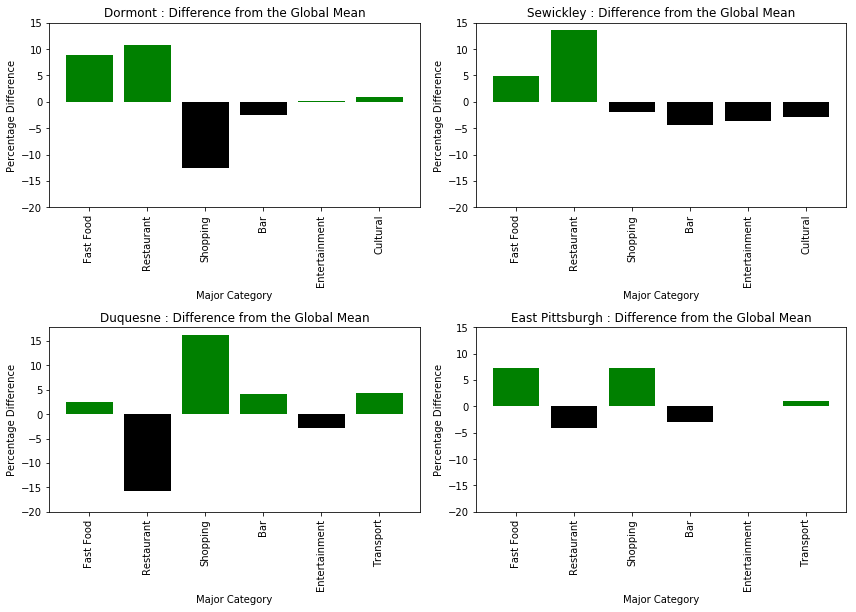

In [19]:
#Select the 4 example neighborhoods and call the plot function
neighborhoods = ['Dormont','Sewickley','Duquesne','East Pittsburgh']

fig = plt.figure(figsize=(12, 20))

for count in range(0,4):
    plot_neighborhood_mean_difference(neighborhoods,count)
fig.tight_layout()
plt.show()

In [20]:
#create function to display the legend on the folium map
#Reference : https://tilemill-project.github.io/tilemill/docs/guides/advanced-legends/
def create_legend():

    template = """
    {% macro html(this, kwargs) %}

    <!doctype html>
    <html lang="en">
    <head>
      <meta charset="utf-8">
      <meta name="viewport" content="width=device-width, initial-scale=1">
      <title>jQuery UI Draggable - Default functionality</title>
      <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

      <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
      <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>
  
      <script>
      $( function() {
        $( "#maplegend" ).draggable({
                    start: function (event, ui) {
                        $(this).css({
                            right: "auto",
                            top: "auto",
                            bottom: "auto"
                        });
                    }
                });
    });

      </script>
    </head>
    <body>

 
    <div id='maplegend' class='maplegend' 
        style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
        border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
    <div class='legend-title'>Category</div>
    <div class='legend-scale'>
      <ul class='legend-labels'>
        <li><span style='background:grey;opacity:0.7;'></span>Services</li>
        <li><span style='background:red;opacity:0.7;'></span>Entertainment</li>
        <li><span style='background:green;opacity:0.7;'></span>Transport</li>
        <li><span style='background:blue;opacity:0.7;'></span>Accomodation</li>
        <li><span style='background:yellow;opacity:0.7;'></span>Shopping</li>
        <li><span style='background:cyan;opacity:0.7;'></span>Bar</li>
        <li><span style='background:purple;opacity:0.7;'></span>Fast Food</li>
        <li><span style='background:black;opacity:0.7;'></span>Cultural</li>
        <li><span style='background:darkorange;opacity:0.7;'></span>Restaurant</li>
      </ul>
    </div>
    </div>
 
    </body>
    </html>

    <style type='text/css'>
      .maplegend .legend-title {
        text-align: left;
        margin-bottom: 5px;
        font-weight: bold;
        font-size: 90%;
        }
      .maplegend .legend-scale ul {
        margin: 0;
        margin-bottom: 5px;
        padding: 0;
        float: left;
        list-style: none;
        }
      .maplegend .legend-scale ul li {
        font-size: 80%;
        list-style: none;
        margin-left: 0;
        line-height: 18px;
        margin-bottom: 2px;
        }
      .maplegend ul.legend-labels li span {
        display: circle;
        border-radius: 50%;
        float: left;
        height: 16px;
        width: 16px;
        margin-right: 5px;
        margin-left: 0;
        border: 1px solid #999;
        }
      .maplegend .legend-source {
        font-size: 80%;
        color: #777;
        clear: both;
        }
      .maplegend a {
        color: #777;
        }
    </style>
    {% endmacro %}"""

    return(template)

In [21]:
#create a catgeory color dictionary to ensure consistency between runs
category_color_dict = {'Entertainment':'red',
                      'Transport':'yellow',
                      'Accomodation':'blue',
                      'Shopping':'purple',
                      'Bar':'cyan',
                      'Fast Food':'green',
                      'Cultural':'black',
                      'Restaurant':'darkorange'}

In [22]:
# create map function
def create_map(latitude,longitude):
    map_clusters = folium.Map(location=[latitude, longitude], zoom_start=15)

    # add markers to the map
    for lat, lon, poi, major_category,cluster in zip(venues_nearby['Venue Latitude'], 
                                                 venues_nearby['Venue Longitude'], 
                                                 venues_nearby.Neighborhood, 
                                                 venues_nearby['Major Category'],
                                                 venues_nearby.kmeans):
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster) + ' : ' + str(major_category), parse_html=True)
 
        folium.CircleMarker(
            [lat, lon],
            radius=5,
            popup=label,
            color=category_color_dict.get(major_category),
            fill=True,
            fill_color=category_color_dict.get(major_category),
            fill_opacity=0.7).add_to(map_clusters)
    
    macro = MacroElement()
    macro._template = Template(create_legend())

    map_clusters.get_root().add_child(macro)
 
    display(map_clusters)


In [23]:
#for the 4 example neighborhoods, create and display the map
for neighborhood in neighborhoods:
    latitude = venues_nearby.loc[venues_nearby['Neighborhood'] == neighborhood]['Neighborhood Latitude'].unique()[0]
    longitude = venues_nearby.loc[venues_nearby['Neighborhood'] == neighborhood]['Neighborhood Longitude'].unique()[0]
    create_map(latitude,longitude)

In [ ]:
#for the 4 example neighborhoods, create and display the map
for neighborhood in neighborhoods:
    latitude = venues_nearby.loc[venues_nearby['Neighborhood'] == neighborhood]['Neighborhood Latitude'].unique()[0]
    longitude = venues_nearby.loc[venues_nearby['Neighborhood'] == neighborhood]['Neighborhood Longitude'].unique()[0]
    create_map(latitude,longitude)